In [1]:
%reload_ext autotime
import pandas as pd
import requests
from pprint import pprint
import json
import torch
from PIL import Image
from transformers import MllamaForConditionalGeneration, AutoProcessor
from tqdm.auto import tqdm

pd.options.plotting.backend = "plotly"
pd.set_option("display.max_columns", None)
pd.set_option("display.max_colwidth", 100)

2024-12-16 12:12:29.284009: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-12-16 12:12:29.296515: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-12-16 12:12:29.313946: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-12-16 12:12:29.319666: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-12-16 12:12:29.334112: I tensorflow/core/platform/cpu_feature_guar

In [2]:
df = pd.read_csv("results.csv").drop_duplicates(subset="panoid")
df

,Index,pid,n,time,anxiousness,latitude,longitude,geometry,panoid,panolat,panolon,panodate,panothirdparty,source,uploader
0,0,P20001,1,2023-04-25T02:51:42Z,0,-36.924795,174.738044,POINT (174.7380435 -36.92479483),IvrcS0W1RlFAlnci-p39XA,-36.924665,174.737914,2012-04,False,launch,NaN
10,10,P20001,11,2023-04-24T00:42:25Z,0,-36.924837,174.737948,POINT (174.7379477 -36.92483659),QEpZV7bnO2mBfp0weMUKEg,-36.924730,174.737826,2012-04,False,launch,NaN
13,13,P20006,1,2023-06-03T02:45:55Z,3,-36.892203,174.740125,POINT (174.7401253 -36.89220256),omb98QNjTPWi0uUfMsmYeg,-36.892621,174.739961,2024-05,False,launch,NaN
14,15,P20009,2,2023-05-17T04:54:48Z,3,-36.923191,174.748620,POINT (174.7486203 -36.92319093),E7B5AV3DQ1rYWDClVRo8Zg,-36.923194,174.748831,2024-05,False,launch,NaN
17,19,P20009,6,2023-05-19T22:28:51Z,1,-36.923260,174.748655,POINT (174.748655 -36.92325959),KCTcsxYCIm41XdzkYEYUQw,-36.923286,174.748840,2024-05,False,launch,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1314,1421,P20693,2,2024-05-02T03:43:23Z,3,-36.897778,174.721580,POINT (174.7215796 -36.89777786),Uzuqd6oSo-EjCVuRP2Os0Q,-36.897742,174.721877,2022-06,False,launch,NaN
1317,1425,P20693,6,2024-05-05T03:00:22Z,2,-36.969426,174.790602,POINT (174.7906024 -36.96942642),4OskePS4Ilz12JhsP-1ujg,-36.969164,174.790848,2022-08,False,launch,NaN
1318,1426,P20721,1,2024-05-05T02:00:52Z,1,-36.893455,174.728262,POINT (174.728262 -36.89345532),CfRtPfDMNhfXHTNvMwnYRw,-36.893394,174.728062,2024-06,False,launch,NaN
1320,1428,P20721,3,2024-05-05T23:06:27Z,2,-36.845252,174.759951,POINT (174.7599508 -36.8452515),AF1QipN2FD2eYEmK8bRpEgoM7fFl5-nUstwWujnRj0gv,-36.845292,174.759939,2022-06-24,True,photos:street_view_publish_api,Mint Design


In [3]:
# Loading this model needs about 22.69GB of GPU memory
model_id = "meta-llama/Llama-3.2-11B-Vision-Instruct"

model = MllamaForConditionalGeneration.from_pretrained(
    model_id,
    torch_dtype=torch.bfloat16,
    device_map="auto",
)
processor = AutoProcessor.from_pretrained(model_id)

The model weights are not tied. Please use the `tie_weights` method before using the `infer_auto_device` function.


Loading checkpoint shards:   0%|          | 0/5 [00:00<?, ?it/s]

0it [00:00, ?it/s]

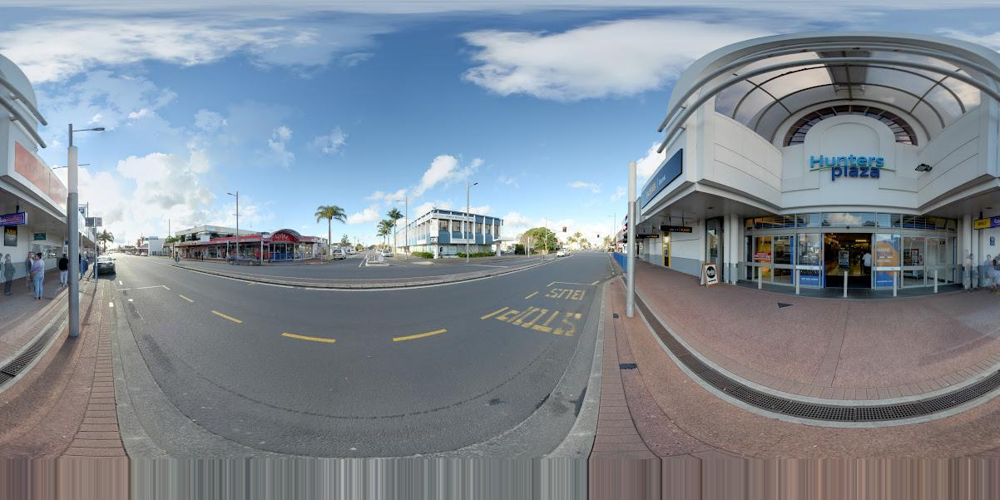

Output:
{'active_transport': False,
 'bikes': 1,
 'cars': 5,
 'dwellings': 5,
 'environment': 'commercial',
 'green': 40,
 'obscured': 20,
 'offices': 0,
 'people': 10,
 'quality': 70,
 'shops': 3,
 'water': 0}




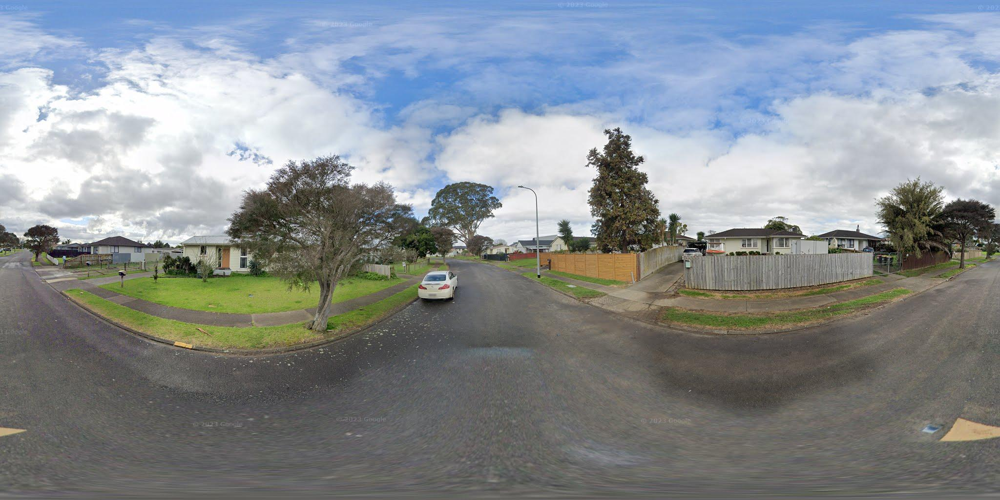

Output:
{'active_transport': False,
 'bikes': 0,
 'cars': 1,
 'dwellings': 6,
 'environment': 'low density residential',
 'green': 50,
 'obscured': 30,
 'offices': 0,
 'people': 1,
 'quality': 60,
 'shops': 1,
 'water': 200}




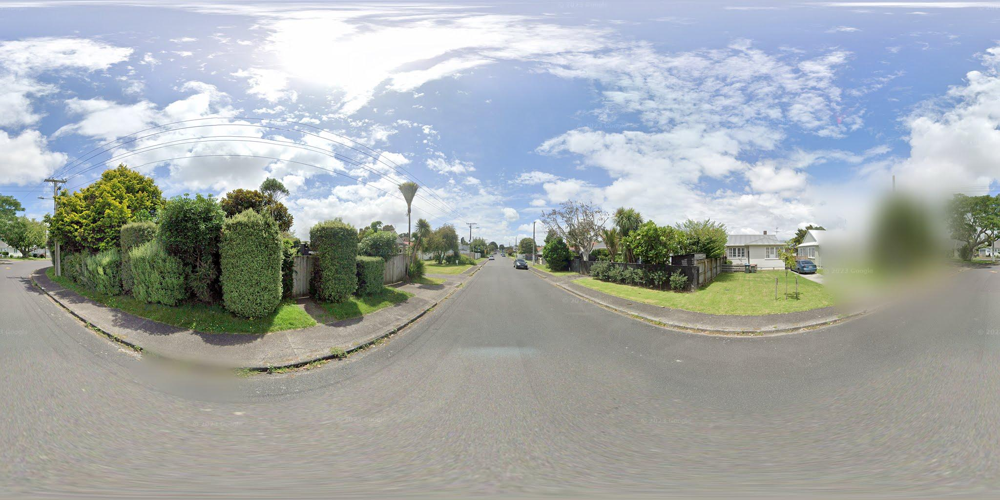

Output:
{'active_transport': True,
 'bikes': 0,
 'cars': 1,
 'dwellings': 4,
 'environment': 'low density residential',
 'green': 58,
 'obscured': 30,
 'offices': 0,
 'people': 1,
 'quality': 80,
 'shops': 0,
 'water': 0}




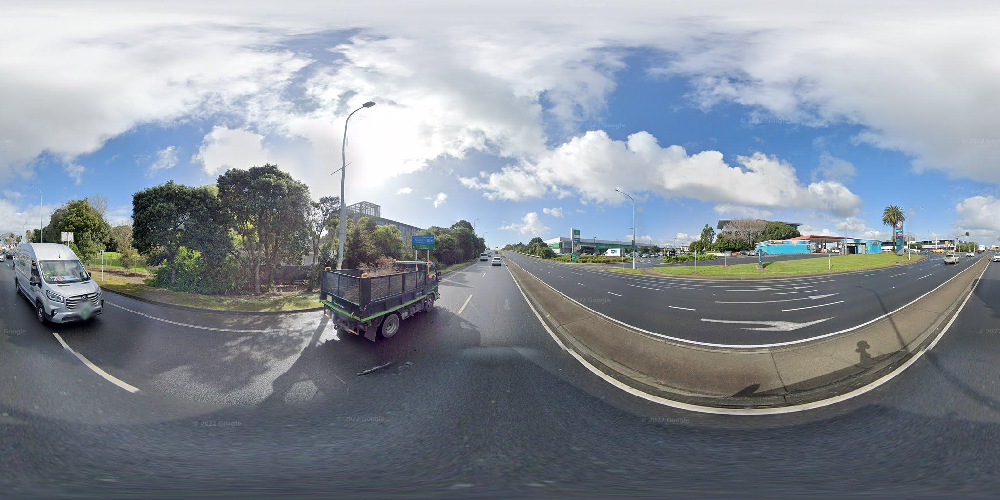

Output:
{'active_transport': False,
 'bikes': 0,
 'cars': 5,
 'dwellings': 3,
 'environment': 'medium density residential',
 'green': 20,
 'obscured': 30,
 'offices': 0,
 'people': 0,
 'quality': 60,
 'shops': 1,
 'water': 200}




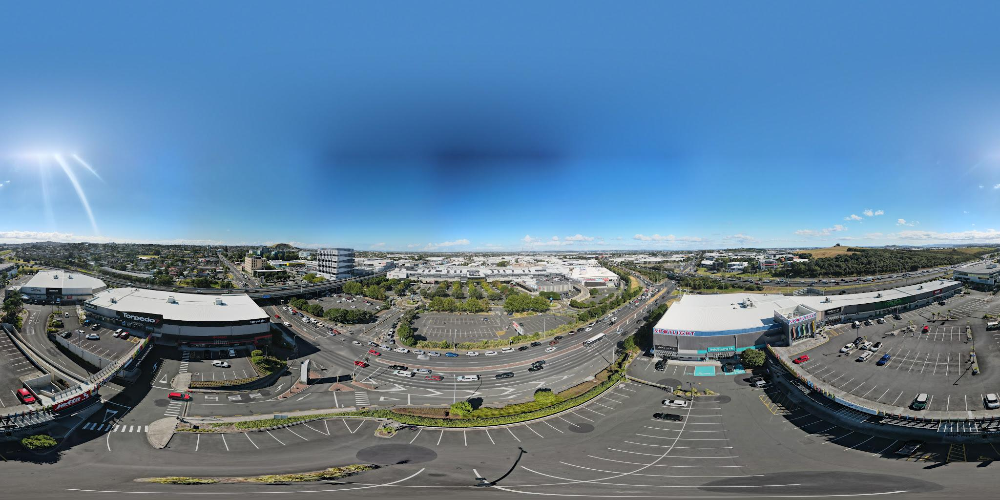

Output:
{'active_transport': True,
 'bikes': 2,
 'cars': 20,
 'dwellings': 15,
 'environment': 'medium density residential',
 'green': 20,
 'obscured': 40,
 'offices': 3,
 'people': 10,
 'quality': 80,
 'shops': 5,
 'water': 0}




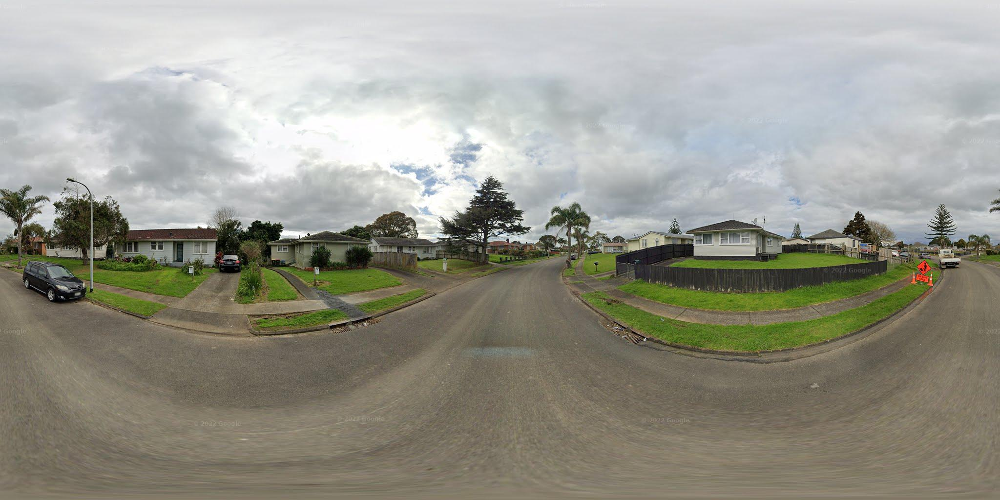

Output:
{'active_transport': False,
 'bikes': 0,
 'cars': 2,
 'dwellings': 10,
 'environment': 'low density residential',
 'green': 30,
 'obscured': 20,
 'offices': 0,
 'people': 0,
 'quality': 50,
 'shops': 0,
 'water': 0}




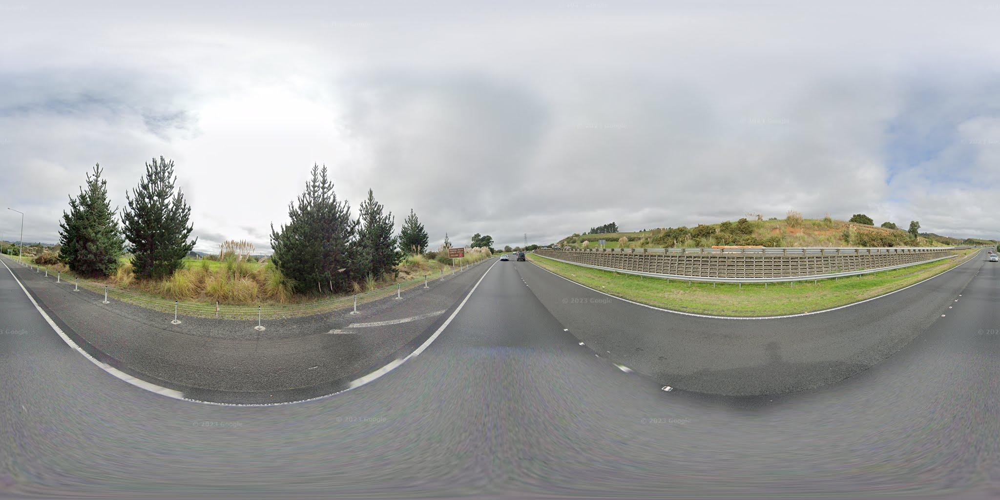

Output:
{'active_transport': False,
 'bikes': 0,
 'cars': 1,
 'dwellings': 3,
 'environment': 'low density residential',
 'green': 40,
 'obscured': 10,
 'offices': 0,
 'people': 0,
 'quality': 70,
 'shops': 1,
 'water': 0}




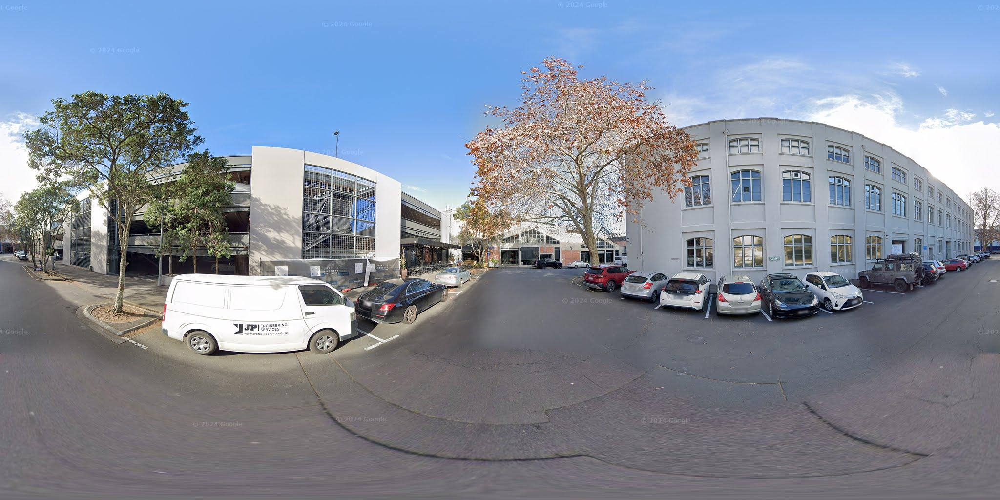

Output:
{'active_transport': True,
 'bikes': 0,
 'cars': 16,
 'dwellings': 2,
 'environment': 'commercial',
 'green': 34,
 'obscured': 44,
 'offices': 0,
 'people': 2,
 'quality': 75,
 'shops': 1,
 'water': 0}




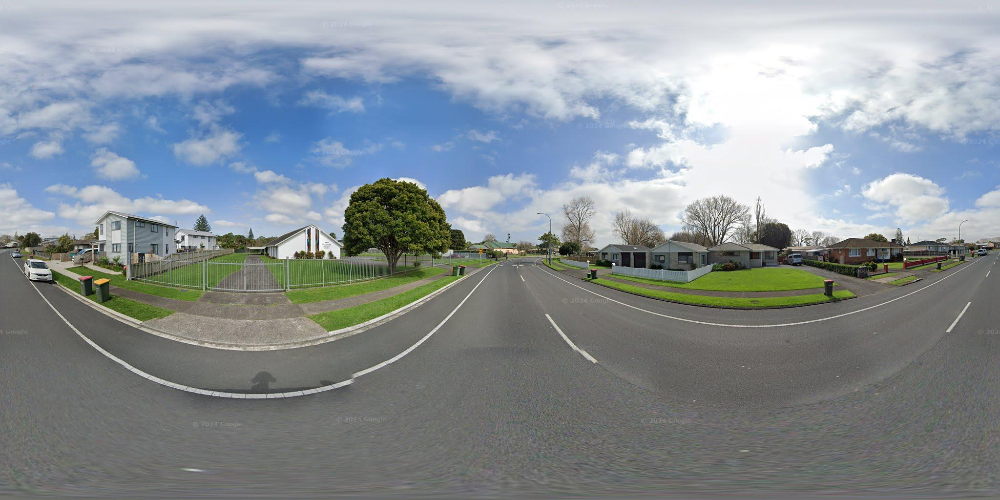

Output:
{'active_transport': False,
 'bikes': 0,
 'cars': 4,
 'dwellings': 11,
 'environment': 'low density residential',
 'green': 60,
 'obscured': 20,
 'offices': 0,
 'people': 0,
 'quality': 70,
 'shops': 0,
 'water': 0}




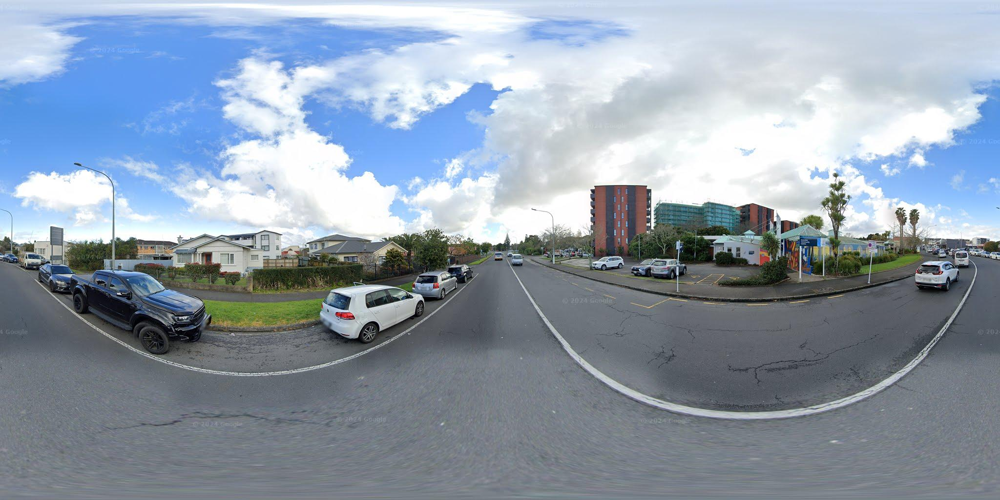

Output:
{'active_transport': True,
 'bikes': 2,
 'cars': 15,
 'dwellings': 10,
 'environment': 'low density residential',
 'green': 50,
 'obscured': 20,
 'offices': 0,
 'people': 0,
 'quality': 80,
 'shops': 3,
 'water': 0}




In [13]:
prompt = """
    This image is a panorama from Google Street View.
    From the image, extract the following information, in JSON format:

    green: The percentage of the image that is green space (e.g., parks, gardens, trees, grass). A number between 0 and 100.
    environment: The general classification of the environment based on the visible surroundings. Choose the closest matching category from the following: "low density residential", "medium density residential", "indoor", "park", "commercial", "shops", "cafes", "supermarket" or suggest a custom classification as a string.
    active_transport: Indicate if an active transport corridor is visible (e.g., bike lane, walking path). Return true or false.
    quality: A subjective assessment of the area's upkeep, where 0 represents "run down" and 100 represents "well maintained." A number between 0 and 100.
    water: If streams, ponds, rivers, or the ocean are visible, estimate the distance to the nearest body of water in meters. If no water is present, return 0.
    obscured: The proportion of the view obscured by buildings (i.e., how much of the total line of sight is blocked by buildings in close proximity). A number between 0 and 100.
    people: The total number of people visible in the image. A whole number.
    cars: The total number of cars visible in the image. A whole number.
    bikes: The total number of bikes visible in the image. A whole number.
    dwellings: The total number of dwellings (houses, flats, or apartments) visible in the image. A whole number.
    shops: The total number of shops visible in the image. A whole number.
    offices: The total number of offices visible in the image. A whole number.

    Do not include comments in your JSON response. Only respond with the JSON object. Make sure the JSON is valid.
"""
for row in tqdm(df.sample(10).itertuples(index=False)):
    panoid = row.panoid
    image = Image.open(f"panoramas/{panoid}.jpg")
    display(image)
    messages = [
        {
            "role": "user",
            "content": [
                {"type": "text", "text": prompt},
                {"type": "image"},
            ]
        }
    ]
    input_text = processor.apply_chat_template(messages, add_generation_prompt=True)
    inputs = processor(
        image,
        input_text,
        add_special_tokens=False,
        return_tensors="pt"
    ).to(model.device)

    for retry in range(3):
        output = model.generate(**inputs, max_new_tokens=5000)
        result = processor.decode(output[0])
        result = result[result.rindex("<|end_header_id|>") + len("<|end_header_id|>"):].strip().replace("<|eot_id|>", "")
        print("Output:")
        try:
            result = json.loads(result)
            pprint(result)
            print("\n")
            break
        except json.JSONDecodeError:
            print(f"Unable to parse: {result}")

In [14]:
results = []
for row in tqdm(df.itertuples(index=False), total=len(df)):
    panoid = row.panoid
    image = Image.open(f"panoramas/{panoid}.jpg")
    #display(image)
    messages = [
        {
            "role": "user",
            "content": [
                {"type": "text", "text": prompt},
                {"type": "image"},
            ]
        }
    ]
    input_text = processor.apply_chat_template(messages, add_generation_prompt=True)
    inputs = processor(
        image,
        input_text,
        add_special_tokens=False,
        return_tensors="pt"
    ).to(model.device)

    for retry in range(3):
        output = model.generate(**inputs, max_new_tokens=5000)
        result = processor.decode(output[0])
        result = result[result.rindex("<|end_header_id|>") + len("<|end_header_id|>"):].strip().replace("<|eot_id|>", "")
        #print("Output:")
        try:
            result = json.loads(result)
            #pprint(result)
            row = row._asdict()
            row.update(result)
            results.append(row)
            #print("\n")
            break
        except json.JSONDecodeError:
            print(f"Unable to parse: {result}")

results = pd.DataFrame(results)
results.to_csv("LLM_results.csv", index=False)
results

  0%|          | 0/592 [00:00<?, ?it/s]

,Index,pid,n,time,anxiousness,latitude,longitude,geometry,panoid,panolat,panolon,panodate,panothirdparty,source,uploader,green,environment,active_transport,quality,water,obscured,people,cars,bikes,dwellings,shops,offices
0,0,P20001,1,2023-04-25T02:51:42Z,0,-36.924795,174.738044,POINT (174.7380435 -36.92479483),IvrcS0W1RlFAlnci-p39XA,-36.924665,174.737914,2012-04,False,launch,NaN,25,low density residential,False,60,0,0,0,2,0,7,2,0
1,10,P20001,11,2023-04-24T00:42:25Z,0,-36.924837,174.737948,POINT (174.7379477 -36.92483659),QEpZV7bnO2mBfp0weMUKEg,-36.924730,174.737826,2012-04,False,launch,NaN,65,low density residential,True,80,0,20,0,1,0,8,0,0
2,13,P20006,1,2023-06-03T02:45:55Z,3,-36.892203,174.740125,POINT (174.7401253 -36.89220256),omb98QNjTPWi0uUfMsmYeg,-36.892621,174.739961,2024-05,False,launch,NaN,60,medium density residential,False,70,100,30,0,1,0,15,1,0
3,15,P20009,2,2023-05-17T04:54:48Z,3,-36.923191,174.748620,POINT (174.7486203 -36.92319093),E7B5AV3DQ1rYWDClVRo8Zg,-36.923194,174.748831,2024-05,False,launch,NaN,44,low density residential,False,70,0,25,0,7,0,17,2,0
4,19,P20009,6,2023-05-19T22:28:51Z,1,-36.923260,174.748655,POINT (174.748655 -36.92325959),KCTcsxYCIm41XdzkYEYUQw,-36.923286,174.748840,2024-05,False,launch,NaN,40,low density residential,True,70,120,30,5,4,1,10,2,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
587,1421,P20693,2,2024-05-02T03:43:23Z,3,-36.897778,174.721580,POINT (174.7215796 -36.89777786),Uzuqd6oSo-EjCVuRP2Os0Q,-36.897742,174.721877,2022-06,False,launch,NaN,25,low density residential,False,60,0,20,1,2,0,8,1,0
588,1425,P20693,6,2024-05-05T03:00:22Z,2,-36.969426,174.790602,POINT (174.7906024 -36.96942642),4OskePS4Ilz12JhsP-1ujg,-36.969164,174.790848,2022-08,False,launch,NaN,30,low density residential,False,60,0,40,0,2,0,7,0,0
589,1426,P20721,1,2024-05-05T02:00:52Z,1,-36.893455,174.728262,POINT (174.728262 -36.89345532),CfRtPfDMNhfXHTNvMwnYRw,-36.893394,174.728062,2024-06,False,launch,NaN,65,low density residential,False,60,200,20,1,2,0,3,1,0
590,1428,P20721,3,2024-05-05T23:06:27Z,2,-36.845252,174.759951,POINT (174.7599508 -36.8452515),AF1QipN2FD2eYEmK8bRpEgoM7fFl5-nUstwWujnRj0gv,-36.845292,174.759939,2022-06-24,True,photos:street_view_publish_api,Mint Design,0,commercial,False,80,0,70,0,6,0,4,4,2
